In [1]:
import pandas as pd
import math
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
#from sklearn.model_selection import train_test_split
#from sklearn import metrics

In [2]:
data=pd.read_csv(r'C:\Users\Srijon\Downloads\loan.csv')

C:\Users\Srijon\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (0,47) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
data.shape

(42542, 111)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42542 entries, 0 to 42541
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(86), object(25)
memory usage: 36.0+ MB


In [5]:
data_dict_all=pd.read_excel('LCDataDictionary.xlsx',sheet_name='LoanStats')

In [6]:
data_dict=data_dict_all.iloc[:,0:2]
data_dict.head()

,LoanStatNew,Description
0,acc_now_delinq,The number of accounts on which the borrower i...
1,acc_open_past_24mths,Number of trades opened in past 24 months.
2,addr_state,The state provided by the borrower in the loan...
3,all_util,Balance to credit limit on all trades
4,annual_inc,The self-reported annual income provided by th...


In [7]:
data_dtypes=pd.DataFrame(data.dtypes,columns=['dtype'])
data_dtypes.reset_index(inplace=True)
data_dtypes.columns=['LoanStatNew', 'dtype']
data_dtypes['first value'] = data.loc[0].values

In [8]:
data_dtypes.head()

,LoanStatNew,dtype,first value
0,id,object,1077501
1,member_id,float64,1.2966e+06
2,loan_amnt,float64,5000
3,funded_amnt,float64,5000
4,funded_amnt_inv,float64,4975


In [9]:
data_col=data_dtypes.merge(data_dict, on='LoanStatNew',how='left')

In [10]:
data_col.head()

,LoanStatNew,dtype,first value,Description
0,id,object,1077501,A unique LC assigned ID for the loan listing.
1,member_id,float64,1.2966e+06,A unique LC assigned Id for the borrower member.
2,loan_amnt,float64,5000,The listed amount of the loan applied for by t...
3,funded_amnt,float64,5000,The total amount committed to that loan at tha...
4,funded_amnt_inv,float64,4975,The total amount committed by investors for th...


In [11]:
d={'LoanStatNew':[],'Nulls':[]}
for i in data.columns:
    d['LoanStatNew'].append(i)
    d['Nulls'].append(len(data[data[i].isnull()][i]))
data_col=data_col.merge(pd.DataFrame(d),on='LoanStatNew')
nulls=pd.DataFrame(d)

In [12]:
data_col.head()

,LoanStatNew,dtype,first value,Description,Nulls
0,id,object,1077501,A unique LC assigned ID for the loan listing.,4
1,member_id,float64,1.2966e+06,A unique LC assigned Id for the borrower member.,7
2,loan_amnt,float64,5000,The listed amount of the loan applied for by t...,7
3,funded_amnt,float64,5000,The total amount committed to that loan at tha...,7
4,funded_amnt_inv,float64,4975,The total amount committed by investors for th...,7


In [13]:
data_y=data['loan_status']
data_y.unique()

array(['Fully Paid', 'Charged Off', 'Current', 'Late (31-120 days)',
       'In Grace Period', 'Late (16-30 days)', 'Default', nan,
       'Does not meet the credit policy. Status:Fully Paid',
       'Does not meet the credit policy. Status:Charged Off'],
      dtype=object)

In [14]:
data_y.value_counts()

Fully Paid                                             34085
Charged Off                                             5662
Does not meet the credit policy. Status:Fully Paid      1988
Does not meet the credit policy. Status:Charged Off      761
Current                                                   19
Late (31-120 days)                                         9
In Grace Period                                            8
Late (16-30 days)                                          2
Default                                                    1
Name: loan_status, dtype: int64

In [15]:
default=['Charged Off','Late (31-120 days)','Late (16-30 days)','Does not meet the credit policy. Status:Charged Off',
         'In Grace Period','Default']
data['loan_status']=data['loan_status'].apply(lambda x: 'Default' if x in default else x)

In [16]:
paid=['Fully Paid','Does not meet the credit policy. Status:Fully Paid']
data['loan_status']=data['loan_status'].apply(lambda x: 'Fully Paid' if x in paid else x)

In [17]:
data_y.value_counts()

Fully Paid    36073
Default        6443
Current          19
Name: loan_status, dtype: int64

In [18]:
data=data[(data['loan_status']=='Default') | (data['loan_status']=='Fully Paid')]

Following are some important points about data:

Data is skewed with the ratio of **15/85**. That is, in 100 rows, only 14 rows refers to 'Default' case which is expected as defaulted cases will always be minimal.
Loan defaulters tend to apply for larger loans.
Around **15%** of funded amount is defaulted

In [79]:
# Data is skewed in the ratio of 15.2/84.8
data['loan_status'].value_counts()[0]/len(data['loan_status'])

0.8484427926232593

In [20]:
data[['loan_amnt','loan_status']].groupby(by='loan_status').mean()

,loan_amnt
loan_status,
Default,11852.611361
Fully Paid,10951.009065


C:\Users\Srijon\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='loan_amnt', ylabel='loan_status'>

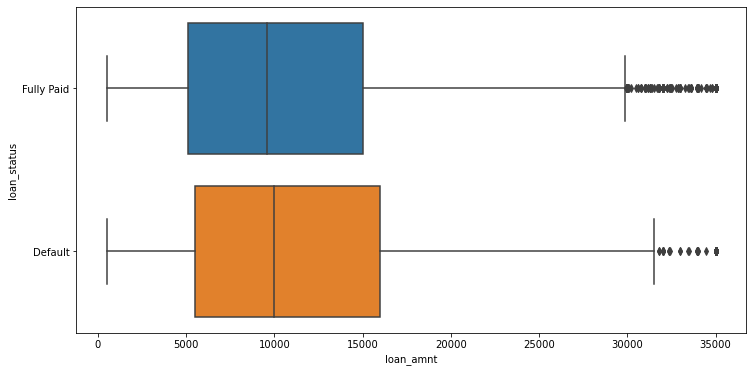

In [21]:
import seaborn as sns
plt.figure(figsize=(12,6))
sns.boxplot(data['loan_amnt'],data['loan_status'])

<AxesSubplot:xlabel='loan_status'>

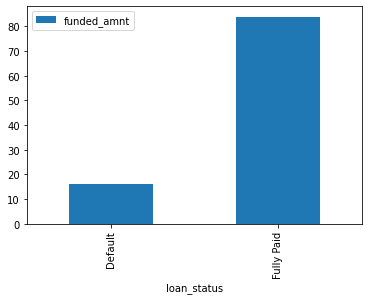

In [22]:
total_funded_amnt=data['funded_amnt'].sum()
(data[['funded_amnt','loan_status']].groupby(by='loan_status').\
         sum()/total_funded_amnt*100).plot(kind='bar')

**Cleaning Part 1**

In [23]:
data_col[0:13]

,LoanStatNew,dtype,first value,Description,Nulls
0,id,object,1077501,A unique LC assigned ID for the loan listing.,4
1,member_id,float64,1.2966e+06,A unique LC assigned Id for the borrower member.,7
2,loan_amnt,float64,5000,The listed amount of the loan applied for by t...,7
3,funded_amnt,float64,5000,The total amount committed to that loan at tha...,7
4,funded_amnt_inv,float64,4975,The total amount committed by investors for th...,7
5,term,object,36 months,The number of payments on the loan. Values are...,7
6,int_rate,object,10.65%,Interest Rate on the loan,7
7,installment,float64,162.87,The monthly payment owed by the borrower if th...,7
8,grade,object,B,LC assigned loan grade,7
9,sub_grade,object,B2,LC assigned loan subgrade,7


In [24]:
#'grade' and 'sub_grade' gives same information
data.drop(['id','member_id','funded_amnt','funded_amnt_inv','installment','sub_grade','emp_title'],axis=1,inplace=True)

In [25]:
data.shape

(42516, 104)

In [26]:
data_col[13:26]

,LoanStatNew,dtype,first value,Description,Nulls
13,annual_inc,float64,24000,The self-reported annual income provided by th...,11
14,verification_status,object,Verified,"Indicates if income was verified by LC, not ve...",7
15,issue_d,object,11-Dec,The month which the loan was funded,7
16,loan_status,object,Fully Paid,Current status of the loan,7
17,pymnt_plan,object,n,Indicates if a payment plan has been put in pl...,7
18,url,object,https://lendingclub.com/browse/loanDetail.acti...,URL for the LC page with listing data.,7
19,desc,object,Borrower added on 12/22/11 > I need to upgra...,Loan description provided by the borrower,13300
20,purpose,object,credit_card,A category provided by the borrower for the lo...,7
21,title,object,Computer,The loan title provided by the borrower,20
22,zip_code,object,860xx,The first 3 numbers of the zip code provided b...,7


In [27]:
data.drop(['url','desc','title','zip_code'],axis=1,inplace=True)
#Info in 'title' and 'purpose' is same

In [28]:
data.shape

(42516, 100)

In [29]:
data_col[26:39]

,LoanStatNew,dtype,first value,Description,Nulls
26,earliest_cr_line,object,Jan-85,The month the borrower's earliest reported cre...,36
27,inq_last_6mths,float64,1,The number of inquiries in past 6 months (excl...,36
28,mths_since_last_delinq,float64,NaN,The number of months since the borrower's last...,26933
29,mths_since_last_record,float64,NaN,The number of months since the last public rec...,38891
30,open_acc,float64,3,The number of open credit lines in the borrowe...,36
31,pub_rec,float64,0,Number of derogatory public records,36
32,revol_bal,float64,13648,Total credit revolving balance,7
33,revol_util,object,83.70%,"Revolving line utilization rate, or the amount...",97
34,total_acc,float64,9,The total number of credit lines currently in ...,36
35,initial_list_status,object,f,The initial listing status of the loan. Possib...,7


In [30]:
data.drop(['mths_since_last_delinq','mths_since_last_record','out_prncp','out_prncp_inv','total_pymnt'],
          axis=1,inplace=True)

In [31]:
data.shape

(42516, 95)

In [32]:
data_col[39:52]

,LoanStatNew,dtype,first value,Description,Nulls
39,total_pymnt_inv,float64,5833.84,Payments received to date for portion of total...,7
40,total_rec_prncp,float64,5000,Principal received to date,7
41,total_rec_int,float64,863.16,Interest received to date,7
42,total_rec_late_fee,float64,0,Late fees received to date,7
43,recoveries,float64,0,post charge off gross recovery,7
44,collection_recovery_fee,float64,0,post charge off collection fee,7
45,last_pymnt_d,object,15-Jan,Last month payment was received,90
46,last_pymnt_amnt,float64,171.62,Last total payment amount received,7
47,next_pymnt_d,object,NaN,Next scheduled payment date,39754
48,last_credit_pull_d,object,16-Dec,The most recent month LC pulled credit for thi...,11


In [33]:
data.drop(['total_pymnt_inv','total_rec_prncp','total_rec_int','total_rec_late_fee','recoveries',
          'collection_recovery_fee','last_pymnt_d','last_pymnt_amnt','next_pymnt_d','last_credit_pull_d',
           'collections_12_mths_ex_med','policy_code','mths_since_last_major_derog'],
          axis=1,inplace=True)

In [34]:
data.shape

(42516, 82)

In [35]:
data_col[52:]

,LoanStatNew,dtype,first value,Description,Nulls
52,application_type,object,INDIVIDUAL,Indicates whether the loan is an individual ap...,7
53,annual_inc_joint,float64,NaN,The combined self-reported annual income provi...,42542
54,dti_joint,float64,NaN,A ratio calculated using the co-borrowers' tot...,42542
55,verification_status_joint,float64,NaN,NaN,42542
56,acc_now_delinq,float64,0,The number of accounts on which the borrower i...,36
57,tot_coll_amt,float64,NaN,Total collection amounts ever owed,42542
58,tot_cur_bal,float64,NaN,Total current balance of all accounts,42542
59,open_acc_6m,float64,NaN,Number of open trades in last 6 months,42542
60,open_il_6m,float64,NaN,Number of currently active installment trades,42542
61,open_il_12m,float64,NaN,Number of installment accounts opened in past ...,42542


In [36]:
# Drop any column with more than 50% missing values
data = data.dropna(thresh=(len(data)/2),axis=1) 

In [37]:
#pd.set_option("display.max_rows", None)
data.columns

Index(['loan_amnt', 'term', 'int_rate', 'grade', 'emp_length',
       'home_ownership', 'annual_inc', 'verification_status', 'issue_d',
       'loan_status', 'pymnt_plan', 'purpose', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'application_type', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens'],
      dtype='object')

In [38]:
#data['tax_liens'].value_counts()
data.drop(['earliest_cr_line', 'inq_last_6mths','pub_rec', 'revol_bal', 'acc_now_delinq','revol_util',
           'initial_list_status','pub_rec_bankruptcies','chargeoff_within_12_mths','tax_liens'],
          axis=1,inplace=True)

In [39]:
data.shape

(42516, 19)

In [40]:
data.columns

Index(['loan_amnt', 'term', 'int_rate', 'grade', 'emp_length',
       'home_ownership', 'annual_inc', 'verification_status', 'issue_d',
       'loan_status', 'pymnt_plan', 'purpose', 'addr_state', 'dti',
       'delinq_2yrs', 'open_acc', 'total_acc', 'application_type',
       'delinq_amnt'],
      dtype='object')

In [41]:
data[0:100]

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,purpose,addr_state,dti,delinq_2yrs,open_acc,total_acc,application_type,delinq_amnt
0,5000.0,36 months,10.65%,B,10+ years,RENT,24000.0,Verified,11-Dec,Fully Paid,n,credit_card,AZ,27.65,0.0,3.0,9.0,INDIVIDUAL,0.0
1,2500.0,60 months,15.27%,C,< 1 year,RENT,30000.0,Source Verified,11-Dec,Default,n,car,GA,1.00,0.0,3.0,4.0,INDIVIDUAL,0.0
2,2400.0,36 months,15.96%,C,10+ years,RENT,12252.0,Not Verified,11-Dec,Fully Paid,n,small_business,IL,8.72,0.0,2.0,10.0,INDIVIDUAL,0.0
3,10000.0,36 months,13.49%,C,10+ years,RENT,49200.0,Source Verified,11-Dec,Fully Paid,n,other,CA,20.00,0.0,10.0,37.0,INDIVIDUAL,0.0
5,5000.0,36 months,7.90%,A,3 years,RENT,36000.0,Source Verified,11-Dec,Fully Paid,n,wedding,AZ,11.20,0.0,9.0,12.0,INDIVIDUAL,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101,16000.0,60 months,17.58%,D,7 years,RENT,65000.0,Not Verified,11-Dec,Fully Paid,n,debt_consolidation,KS,15.56,0.0,8.0,16.0,INDIVIDUAL,0.0
102,6000.0,36 months,8.90%,A,8 years,OWN,28800.0,Not Verified,11-Dec,Fully Paid,n,debt_consolidation,NJ,13.17,0.0,11.0,13.0,INDIVIDUAL,0.0
103,7200.0,36 months,9.91%,B,6 years,RENT,135000.0,Not Verified,11-Dec,Fully Paid,n,credit_card,NY,6.12,0.0,7.0,18.0,INDIVIDUAL,0.0
104,9500.0,36 months,8.90%,A,7 years,MORTGAGE,50000.0,Not Verified,11-Dec,Fully Paid,n,credit_card,TX,8.18,0.0,8.0,13.0,INDIVIDUAL,0.0


**Cleaning Part 2**

In [42]:
nulls_percent=[]
for i in data.columns:
    tmp=len(data[data[i].isnull()])/len(data)*100
    nulls_percent.append(round(tmp,2))
null_df=pd.DataFrame(data=nulls_percent,index=data.columns,columns=['% Nulls'])
null_df[null_df['% Nulls']!=0]

,% Nulls
emp_length,2.61
annual_inc,0.01
delinq_2yrs,0.07
open_acc,0.07
total_acc,0.07
delinq_amnt,0.07


In [43]:
data['emp_length'].unique()

array(['10+ years', '< 1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '1 year', '6 years', '2 years', '7 years',
       nan], dtype=object)

In [44]:
def encode_emp_length(x):
    if type(x)==float: #Check for nan ,as only Nans are float while other values are str
        return 0 # nan will be replaced with zero
    if x=='10+ years':
        return 10
    if x=='< 1 year':
        return 0
    else:
        return int(x.split(' ')[0])
    
data['emp_length']=data['emp_length'].apply(encode_emp_length)

In [45]:
data['emp_length'].value_counts()

10    9366
0     6171
2     4741
3     4362
4     3645
1     3592
5     3458
6     2374
7     1875
8     1591
9     1341
Name: emp_length, dtype: int64

In [46]:
data['term'].unique() #Term column has two unique data so for better accessiblity later converted it to binary values.

array([' 36 months', ' 60 months'], dtype=object)

In [47]:
def encode_term(x):
    if x==' 36 months':
        return int(36)
    if x==' 60 months':
        return int(60)

data['term']=data['term'].apply(encode_term)

In [48]:
data['term'].unique() #Term column has two unique data so for better accessiblity later converted it to binary values.

array([36, 60], dtype=int64)

In [49]:
data['grade'].value_counts()

B    12385
A    10183
C     8736
D     6011
E     3390
F     1299
G      512
Name: grade, dtype: int64

In [50]:
def encode_grade(x):
    if x=='A':
        return 1
    if x=='B':
        return 2
    if x=='C':
        return 3
    if x=='D':
        return 4
    if x=='E':
        return 5
    if x=='F':
        return 6
    if x=='G':
        return 7
    
data['grade']=data['grade'].apply(encode_grade)

In [51]:
data['grade'].unique()

array([2, 3, 1, 5, 6, 4, 7], dtype=int64)

In [52]:
data['home_ownership'].value_counts()

RENT        20169
MORTGAGE    18952
OWN          3251
OTHER         136
NONE            8
Name: home_ownership, dtype: int64

In [53]:
#Change OTHER, NONE to RENT as these data points are too low.
data['home_ownership']=data['home_ownership'].apply(lambda x: 'RENT' if x in ['OTHER','NONE'] else x)

In [54]:
# rent =1, mortgage=2, own=3
def encode_home(x):
    if x=='RENT':
        return 1
    if x=='MORTGAGE':
        return 2
    if x=='OWN':
        return 3
    
data['home_ownership']=data['home_ownership'].apply(encode_home)

In [55]:
data['verification_status'].unique()

array(['Verified', 'Source Verified', 'Not Verified'], dtype=object)

In [56]:
# Not verified=0, verified=1, source verified=2
def encode_status(x):
    if x=='Not Verified':
        return 0
    if x=='Verified':
        return 1
    if x=='Source Verified':
        return 2
    
data['verification_status']=data['verification_status'].apply(encode_status)

'loan_amnt', 'term', 'int_rate', 'grade', 'emp_length',
       'home_ownership', 'annual_inc', 'verification_status', 'issue_d',
       'loan_status', 'pymnt_plan', 'purpose', 'addr_state', 'dti',
       'delinq_2yrs', 'open_acc', 'total_acc', 'application_type',
       'delinq_amnt'

In [57]:
data['int_rate'].value_counts()

10.99%    970
11.49%    837
13.49%    832
7.51%     787
7.88%     742
         ... 
18.72%      1
21.48%      1
17.46%      1
17.44%      1
24.40%      1
Name: int_rate, Length: 394, dtype: int64

In [58]:
def encode_int_rate(x):
    x=x.rstrip(x[-1])
    return float(x)

data['int_rate']=data['int_rate'].apply(encode_int_rate)

In [59]:
data.drop('pymnt_plan',axis=1,inplace=True)

In [60]:
data.shape

(42516, 18)

In [61]:
#data['purpose'].nunique()
data['purpose'].value_counts()

debt_consolidation    19766
credit_card            5474
other                  4423
home_improvement       3198
major_purchase         2310
small_business         1990
car                    1615
wedding                1004
medical                 753
moving                  629
house                   426
educational             422
vacation                400
renewable_energy        106
Name: purpose, dtype: int64

In [62]:
#data['application_type'].value_counts()
data.drop('application_type',axis=1,inplace=True)

In [63]:
data.drop('issue_d',axis=1,inplace=True)
data.drop('purpose',axis=1,inplace=True)
data.drop('addr_state',axis=1,inplace=True)

In [64]:
data['loan_status']=data['loan_status'].apply(lambda x: 1 if x=='Default' else 0)

In [65]:
data.drop('delinq_2yrs',axis=1,inplace=True)
data.drop('delinq_amnt',axis=1,inplace=True)

In [66]:
data.shape

(42516, 12)

In [67]:
data['open_acc']=data['open_acc'].replace(np.nan, 0)
data['open_acc'].isnull().sum()

0

In [68]:
data['total_acc']=data['total_acc'].replace(np.nan, 0)
data['total_acc'].isnull().sum()

0

In [69]:
#data['annual_inc']=data['annual_inc'].replace(np.nan, 0)  index=42536,42483,42452,42453

data.drop([42452,42453,42483,42536],inplace=True)
#data.drop(index=42453, columns='annual_inc')
#data.drop(index=42483, columns='annual_inc')
#data.drop(index=42536, columns='annual_inc')

#data['annual_inc'].isnull().sum()
data.shape

(42512, 12)

In [70]:
#plt.bar(data['loan_status'],width=0.5,height=1.0)
#plt.show()

In [71]:
pd.set_option("display.max_rows", None)
#data[42500:42537]
data

,loan_amnt,term,int_rate,grade,emp_length,home_ownership,annual_inc,verification_status,loan_status,dti,open_acc,total_acc
0,5000.0,36,10.65,2,10,1,24000.00,1,0,27.65,3.0,9.0
1,2500.0,60,15.27,3,0,1,30000.00,2,1,1.00,3.0,4.0
2,2400.0,36,15.96,3,10,1,12252.00,0,0,8.72,2.0,10.0
3,10000.0,36,13.49,3,10,1,49200.00,2,0,20.00,10.0,37.0
5,5000.0,36,7.90,1,3,1,36000.00,2,0,11.20,9.0,12.0
6,7000.0,60,15.96,3,8,1,47004.00,0,0,23.51,7.0,11.0
7,3000.0,36,18.64,5,9,1,48000.00,2,0,5.35,4.0,4.0
8,5600.0,60,21.28,6,4,3,40000.00,2,1,5.55,11.0,13.0
9,5375.0,60,12.69,2,0,1,15000.00,1,1,18.08,2.0,3.0
10,6500.0,60,14.65,3,5,3,72000.00,0,0,16.12,14.0,23.0


In [72]:
#data=(data-data.mean())/data.std()
#data
#total_funded_amnt=data['loan_amnt'].sum()
#(data[['loan_amnt','loan_status']].groupby(by='loan_status').\
#         sum()/total_funded_amnt*100).plot(kind='bar')
data['loan_status'].value_counts()

0    36069
1     6443
Name: loan_status, dtype: int64

In [73]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.datasets import load_iris

In [74]:
x=[0,1,2,3,4,5,6,7,9,10,11]
X=data.iloc[:,x]
Y=data.iloc[:,8]
Y[0:4]

0    0
1    1
2    0
3    0
Name: loan_status, dtype: int64

In [75]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=100) # 80% training and 20% test
clf = DecisionTreeClassifier()
clf.fit(X_train,Y_train)
Y_pred = clf.predict(X_test)
print("Accuracy:",metrics.accuracy_score(Y_test, Y_pred))

Accuracy: 0.7411554384644335


In [84]:
from sklearn.metrics import confusion_matrix
#confusion_matrix(Y_test, Y_pred)
print(confusion_matrix(Y_test, Y_pred))

[[7486 1498]
 [1253  391]]


In [83]:
from sklearn.metrics import classification_report
print(classification_report(Y_test,Y_pred))

              precision    recall  f1-score   support

           0       0.86      0.83      0.84      8984
           1       0.21      0.24      0.22      1644

    accuracy                           0.74     10628
   macro avg       0.53      0.54      0.53     10628
weighted avg       0.76      0.74      0.75     10628



In [76]:
x=[0,1,2,3,4,5,6,7,9,10,11]
#X=data.iloc[:,x]
#Y=data.iloc[:,9]
#Y[0:4]

In [77]:
#X = np.array(data.drop('loan_status', axis=1))
X=np.array(data.iloc[:,x])
y = np.array(data['loan_status'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)
accuracy = clf.score(X_test, y_test)
print('Accuracy', accuracy)

Accuracy 0.8468775726214277


In [86]:
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))

[[7180   31]
 [1271   21]]


In [87]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.85      1.00      0.92      7211
           1       0.40      0.02      0.03      1292

    accuracy                           0.85      8503
   macro avg       0.63      0.51      0.47      8503
weighted avg       0.78      0.85      0.78      8503

